Importing packages for parametric umap

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import umap
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
import vaex
import pickle
from umap import ParametricUMAP

Importing packages for classification

In [2]:
import tensorflow as tf
from tqdm.autonotebook import tqdm
from IPython import display
import copy
import os, tempfile
import tensorflow_addons as tfa

Importing the dataset containing SSPP, Pristine w/ photometric metallicities, xmatched Guillaume Table 

In [3]:
pristine = pd.read_csv('/arc/home/aydanmckay/mega.csv')

/tmp/ipykernel_4663/3101453311.py:1: DtypeWarning: Columns (55,80) have mixed types. Specify dtype option on import or set low_memory=False.
  pristine = pd.read_csv('/arc/home/aydanmckay/mega.csv')


In [4]:
pristine.columns

Index(['CaHK_pp', 'CaHKerr_pp', 'Flag_pp', 'EBV_pp', 'source_id_pp', 'RA_pp',
       'DEC_pp', 'Gmag_pp', 'BPmag_pp', 'RPmag_pp', 'FeHphot_gen_pp',
       'FeHphot_dwarf_pp', 'FeHphot_giant_pp', 'RA(CaHK)_cp', 'Dec(CaHK)_cp',
       'CaHK_0_cp', 'e_CaHK_cp', 'E_BV_cp', 'source_id_1_cp', 'pm_1_cp',
       'pmra_1_cp', 'pmra_error_1_cp', 'pmdec_1_cp', 'pmdec_error_1_cp',
       'parallax_1_cp', 'parallax_error_1_cp', 'parallax_2_cp',
       'parallax_error_2_cp', 'phot_g_mean_mag_1_cp', 'phot_bp_mean_mag_1_cp',
       'phot_rp_mean_mag_1_cp', 'phot_g_mean_mag_error_cp',
       'phot_bp_mean_mag_error_cp', 'phot_rp_mean_mag_error_cp',
       'g_chp_psf_cp', 'g_chp_psf_err_cp', 'r_chp_psf_cp', 'r_chp_psf_err_cp',
       'i_chp_psf_cp', 'i_chp_psf_err_cp', 'z_chp_psf_cp', 'z_chp_psf_err_cp',
       'y_chp_psf_cp', 'y_chp_psf_err_cp', 'MAG_AUTO_cp', 'MAGERR_AUTO_cp',
       'MAG_BEST_cp', 'MAGERR_BEST_cp', 'dr2_radial_velocity_1_cp',
       'dr2_radial_velocity_error_1_cp', 'dr2_rv_nb_transi

In [5]:
pristine.g_chp_psf_cp.value_counts()

1.000000e+20    2577
1.347900e+01      27
1.349100e+01      25
1.345600e+01      25
1.349800e+01      24
                ... 
1.832028e+01       1
1.945419e+01       1
1.835965e+01       1
1.877905e+01       1
1.993247e+01       1
Name: g_chp_psf_cp, Length: 2071994, dtype: int64

In [6]:
pristine[np.isnan(pristine['y_chp_psf_cp']) == False]

,CaHK_pp,CaHKerr_pp,Flag_pp,EBV_pp,source_id_pp,RA_pp,DEC_pp,Gmag_pp,BPmag_pp,RPmag_pp,...,SNR_s,PRIM_TARGET_s,TEFF_SPEC_s,TEFF_SPEC_UNC_s,LOGG_SPEC_s,LOGG_SPEC_UNC_s,FEH_SPEC_s,FEH_SPEC_UNC_s,TEFF_COL_s,TEFF_COL_UNC_s
1820673,22.267,0.002,-1,0.013,1536943708887983872,181.00251,40.95830,14.549,14.846,14.082,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1820674,23.387,0.004,1,0.013,1536927314997646592,181.07495,40.81495,15.510,15.828,15.037,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1820675,23.385,0.004,1,0.013,1536932164015890176,181.08279,40.96875,15.599,15.927,15.093,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1820676,23.635,0.004,1,0.013,1536932404534059648,181.05661,40.98760,14.337,14.939,13.597,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1820677,23.769,0.005,1,0.013,1536937421055859456,181.12451,40.99104,15.047,15.502,14.430,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9211977,23.027,0.005,-1,0.019,844813439989942272,173.17366,55.98417,14.810,15.186,14.264,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9211979,23.620,0.007,-1,0.015,844813577428894720,173.24812,56.01051,16.032,16.309,15.587,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9211980,24.739,0.012,-1,0.019,844813435694052736,173.17077,55.98219,17.305,17.554,16.875,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9211982,25.857,0.025,-1,0.018,844793133384585088,173.09239,55.98213,17.554,17.961,16.981,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Making the same cuts as in Pristine Survey I \
making sure that all values exist for Pan-STARRS, CFIS, Gaia, proper motions, logg (which implies FeH and Teff) \
radial velocity < 10, Teff < 7000K, metallcitiy uncertainty < 0.2, CaHK magnitude error < 0.05, metall

In [7]:
pristine = pristine.loc[(pristine["g_chp_psf_cp"] < 1e19) & (pristine["r_chp_psf_cp"] < 1e19) & (pristine["i_chp_psf_cp"] < 1e19) & \
                        (pristine["z_chp_psf_cp"] < 1e19) & (pristine["y_chp_psf_cp"] < 1e19) & (pristine["MAG_AUTO_cp"] < 95) & \
                        (np.isnan(pristine["phot_g_mean_mag_1_cp"]) == False) & (np.isnan(pristine["phot_bp_mean_mag_1_cp"]) == False) & \
                        (np.isnan(pristine["pmra_1_cp"]) == False) & (np.isnan(pristine["pmdec_1_cp"]) == False) & \
                        (np.isnan(pristine["pmra_error_1_cp"]) == False) & (np.isnan(pristine["pmdec_error_1_cp"]) == False) & \
                        (np.isnan(pristine["phot_rp_mean_mag_1_cp"]) == False) & (pristine['SNR_s'] > 25.) & (np.isnan(pristine['LOGG_ADOP_s']) == False) & \
                        (pristine['RV_ADOP_UNC_s'] < 10.) & (pristine['TEFF_ADOP_s'] < 7000.) & (pristine['FEH_ADOP_UNC_s'] < 0.2) & \
                        (pristine["e_CaHK_cp"] < 0.05) & (pristine['FEH_ADOP_s'] > -5)]
pristine.shape

(20974, 89)

creating a new dataframe so that the indeces are reset to 0,1,2,...

In [8]:
df = pd.DataFrame({'PMRA': pristine['pmra_1_cp'], 
                   'PMDec': pristine['pmdec_1_cp'],
                   # 'EBV': pristine['EBV_pp'],
                   'G_gaia': pristine['CaHK_pp']-pristine['Gmag_pp'],
                   'B_gaia': pristine['CaHK_pp']-pristine['BPmag_pp'],
                   'R_gaia': pristine['CaHK_pp']-pristine['RPmag_pp'],
                   'G_pan': pristine['CaHK_pp']-pristine['g_chp_psf_cp'],
                   'R_pan': pristine['CaHK_pp']-pristine['r_chp_psf_cp'],
                   'I_pan': pristine['CaHK_pp']-pristine['i_chp_psf_cp'],
                   'Z_pan': pristine['CaHK_pp']-pristine['z_chp_psf_cp'],
                   'Y_pan': pristine['CaHK_pp']-pristine['y_chp_psf_cp'],
                   'AUTO_cfis': pristine['CaHK_pp']-pristine['MAG_AUTO_cp']})

df2 = pd.DataFrame({'FeH': pristine['FeHphot_gen_pp'],
                    'FeHGiant': pristine['FeHphot_giant_pp'],
                    'FeHDwarf': pristine['FeHphot_dwarf_pp'],
                    'FeHspec': pristine['FEH_ADOP_s']})

In [9]:
df.shape

(20974, 11)

Splitting the data into training and testing labels

In [10]:
train, test, train_labels, test_labels = train_test_split(df, df2, test_size=0.2, random_state=42, shuffle=True)

In [11]:
from DimReductionClustering import *

Creating the model for dimreductionclustering

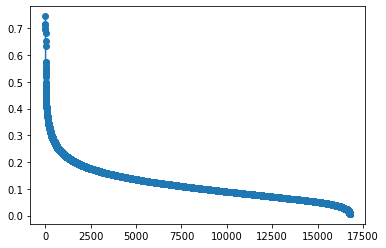

Using elbow method, we found epsilon : 0.2070479087325826


In [12]:
model = DimReductionClustering(n_components=2, min_dist=0, score_metric='silhouette', knn_topk=8, min_pts=20).fit(train)

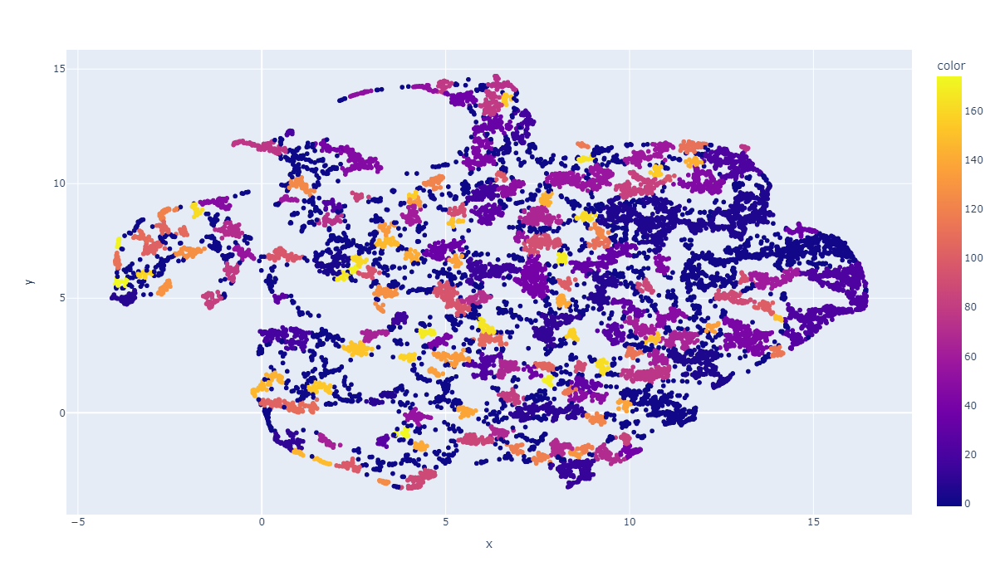

In [13]:
model.display_plotly()

In [14]:
model.score()

0.12186188

Doing the same as above but now on the dataset used to remove extra-galactic contaminants

In [15]:
sdss = pd.read_csv('/arc/home/aydanmckay/leftjoinpristinespecobjmilliquas.csv',
                   usecols=["CaHK_0_p","pmra_1_p","pmdec_1_p","g_chp_psf_p","r_chp_psf_p","i_chp_psf_p","z_chp_psf_p","y_chp_psf_p","MAG_AUTO_p",
                            "phot_g_mean_mag_1_p","phot_bp_mean_mag_1_p","phot_rp_mean_mag_1_p","CLASS_s","RA_q"])
sdss.CLASS_s.value_counts()
sdss = sdss.replace({'CLASS_s':np.nan}, -1) # added to help dimcluster
sdss = sdss.replace({'CLASS_s':'STAR'}, 1)
sdss = sdss.replace({'CLASS_s':'GALAXY'}, 2)
sdss = sdss.replace({'CLASS_s':'QSO'}, 3)

Just making sure the values exist as above, but including RA_q to make sure it doesn't exist within milliquas, making sure it has a label in SDSS

In [16]:
sdss = sdss.loc[(sdss["g_chp_psf_p"] < 1e19) & (sdss["r_chp_psf_p"] < 1e19) & (sdss["i_chp_psf_p"] < 1e19) & \
                        (sdss["z_chp_psf_p"] < 1e19) & (sdss["y_chp_psf_p"] < 1e19) & (sdss["MAG_AUTO_p"] < 95) & \
                        (np.isnan(sdss["pmra_1_p"]) == False) & (np.isnan(sdss["pmdec_1_p"]) == False) & \
                        (np.isnan(sdss["phot_g_mean_mag_1_p"]) == False) & (np.isnan(sdss["phot_bp_mean_mag_1_p"]) == False) & \
                        (np.isnan(sdss["phot_rp_mean_mag_1_p"]) == False) & (np.isnan(sdss['RA_q']) == True) & \
                        (sdss['CLASS_s'] > 0)]
sdss.CLASS_s.value_counts()
# 74165, 9847, 814

1    74165
2     9847
3      814
Name: CLASS_s, dtype: int64

In [17]:
df_joined = vaex.from_pandas(pd.DataFrame({'PMRA': sdss['pmra_1_p'],
                   'PMDec': sdss['pmdec_1_p'],
                   'G_gaia': sdss["CaHK_0_p"]-sdss['phot_g_mean_mag_1_p'],
                   'B_gaia': sdss["CaHK_0_p"]-sdss['phot_bp_mean_mag_1_p'],
                   'R_gaia': sdss["CaHK_0_p"]-sdss['phot_rp_mean_mag_1_p'],
                   'G_pan': sdss["CaHK_0_p"]-sdss['g_chp_psf_p'],
                   'R_pan': sdss["CaHK_0_p"]-sdss['r_chp_psf_p'],
                   'I_pan': sdss["CaHK_0_p"]-sdss['i_chp_psf_p'],
                   'Z_pan': sdss["CaHK_0_p"]-sdss['z_chp_psf_p'],
                   'Y_pan': sdss["CaHK_0_p"]-sdss['y_chp_psf_p'],
                   'AUTO_cfis': sdss["CaHK_0_p"]-sdss['MAG_AUTO_p']
                                          }))
df2 = pd.DataFrame({'Class': sdss['CLASS_s']})

In [18]:
print(df_joined.shape)
df_joined = df_joined.dropna()
print(df_joined.shape)
# print(df2.shape)
# df2 = df2.dropna()
# print(df2.shape)

(84826, 11)
(84826, 11)


In [19]:
scaled_star_data = StandardScaler().fit_transform(df_joined)

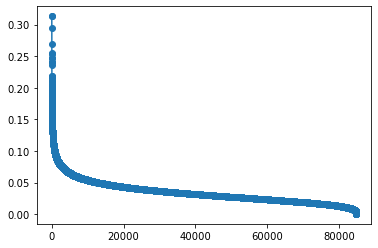

Using elbow method, we found epsilon : 0.06523759865107523


In [20]:
model = DimReductionClustering(n_components=2, min_dist=0.0001, score_metric='silhouette', knn_topk=3, min_pts=20).fit(scaled_star_data)

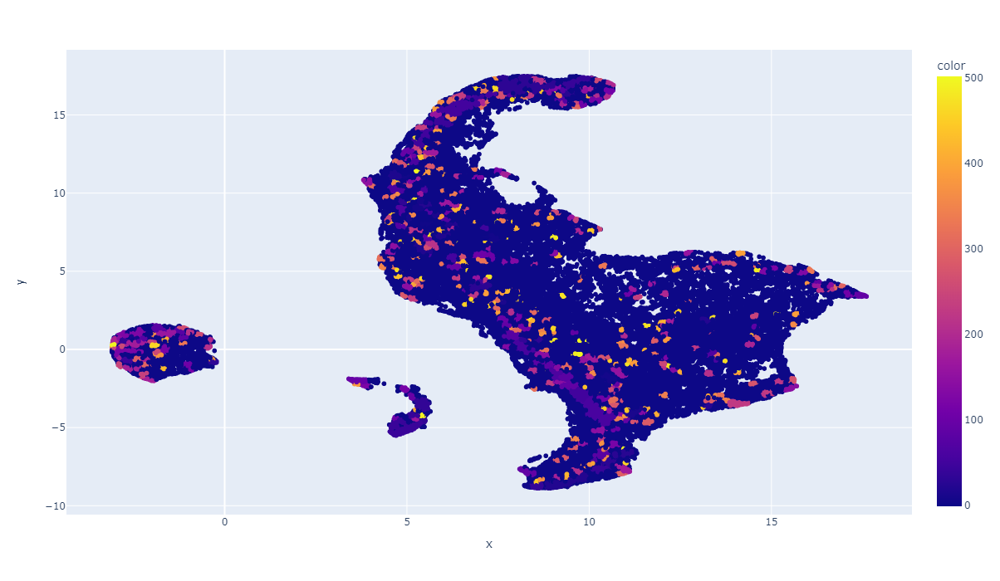

In [21]:
model.display_plotly()

In [22]:
model.score()

-0.4028381

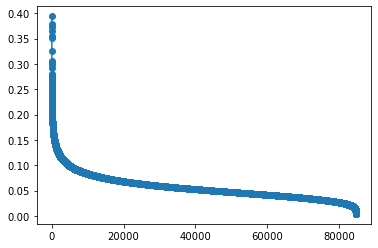

Using elbow method, we found epsilon : 0.09877882759176494


In [23]:
model = DimReductionClustering(n_components=2, min_dist=0, score_metric='silhouette', knn_topk=8, min_pts=40).fit(scaled_star_data)

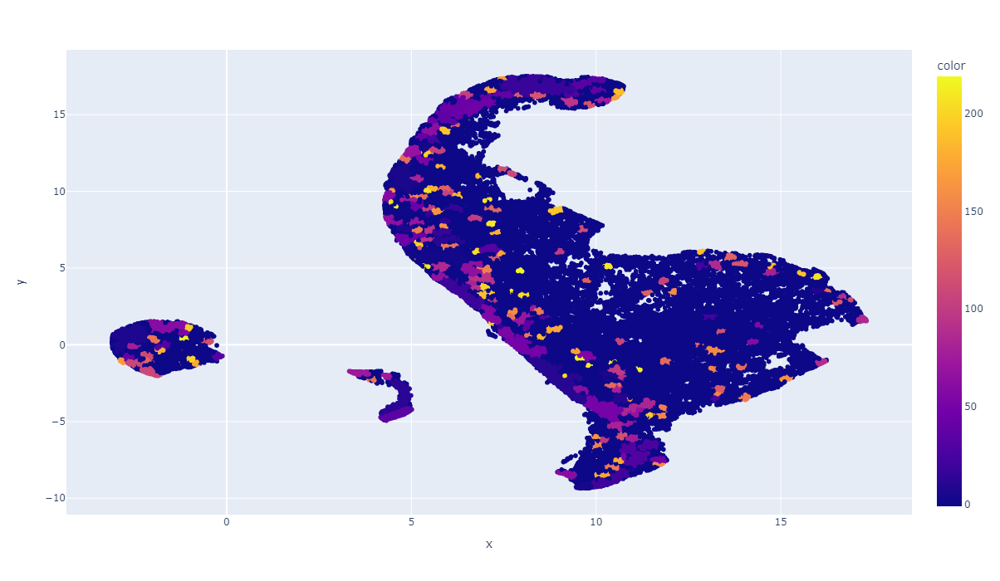

In [24]:
model.display_plotly()

In [25]:
model.score()

-0.37821415

Now starting the tfumap

Parameters

In [26]:
dataset = "mnist"
labels_per_class = 1024 # 'full'
n_latent_dims = 1024
confidence_threshold = 0.0 # minimum confidence to include in UMAP graph for learned metric
learned_metric = False # whether to use a learned metric, or Euclidean distance between datapoints

augmented = True #
min_dist= 0.001 # min_dist parameter for UMAP
negative_sample_rate = 5 # how many negative samples per positive sample 
batch_size = 128 # batch size 
optimizer = tf.keras.optimizers.Adam(1e-3) # the optimizer to train
optimizer = tfa.optimizers.MovingAverage(optimizer)
label_smoothing = 0.2 # how much label smoothing to apply to categorical crossentropy
max_umap_iterations = 500 # how many times, maximum, to recompute UMAP
max_epochs_per_graph = 10 # how many epochs maximum each graph trains for (without early stopping)
graph_patience = 10 # how many times without improvement to train a new graph
min_graph_delta = 0.0025 # minimum improvement on validation acc to consider an improvement for training

In [27]:
dataset = "mnist"
labels_per_class = 1024 # 'full'
n_latent_dims = 1024
confidence_threshold = 0.0 # minimum confidence to include in UMAP graph for learned metric
learned_metric = False # whether to use a learned metric, or Euclidean distance between datapoints

augmented = True #
min_dist= 0.001 # min_dist parameter for UMAP
negative_sample_rate = 5 # how many negative samples per positive sample 
batch_size = 128 # batch size 
optimizer = tf.keras.optimizers.Adam(1e-3) # the optimizer to train
optimizer = tfa.optimizers.MovingAverage(optimizer)
label_smoothing = 0.2 # how much label smoothing to apply to categorical crossentropy
max_umap_iterations = 500 # how many times, maximum, to recompute UMAP
max_epochs_per_graph = 10 # how many epochs maximum each graph trains for (without early stopping)
graph_patience = 10 # how many times without improvement to train a new graph
min_graph_delta = 0.0025 # minimum improvement on validation acc to consider an improvement for training
from datetime import datetime

In [28]:
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(confidence_threshold)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring 
    + '_umap_augmented'
)
print(datestring)

mnist_0.0_1024____2022_04_07_00_01_19_052210_umap_augmented


Load dataset

In [29]:
from tfumap.semisupervised_keras import load_dataset

ModuleNotFoundError: No module named 'pathlib2'

In [ ]:
(
    X_train,
    X_test,
    X_labeled,
    Y_labeled,
    Y_masked,
    X_valid,
    Y_train,
    Y_test,
    Y_valid,
    Y_valid_one_hot,
    Y_labeled_one_hot,
    num_classes,
    dims
) = load_dataset(dataset, labels_per_class)

Load architecture

In [ ]:
from tfumap.semisupervised_keras import load_architecture

In [ ]:
encoder, classifier, embedder = load_architecture(dataset, n_latent_dims)

Load pretrained weights

In [ ]:
from tfumap.semisupervised_keras import load_pretrained_weights

In [ ]:
encoder, classifier = load_pretrained_weights(dataset, augmented, labels_per_class, encoder, classifier)

Compute pretrained accuracy

In [ ]:
# test current acc
pretrained_predictions = classifier.predict(encoder.predict(X_test, verbose=True), verbose=True)
pretrained_predictions = np.argmax(pretrained_predictions, axis=1)
pretrained_acc = np.mean(pretrained_predictions == Y_test)
print('pretrained acc: {}'.format(pretrained_acc))

get a, b parameters for embeddings

In [ ]:
from tfumap.semisupervised_keras import find_a_b

In [ ]:
a_param, b_param = find_a_b(min_dist=min_dist)

Build network

In [ ]:
from tfumap.semisupervised_keras import build_model

In [ ]:
model = build_model(
    batch_size=batch_size,
    a_param=a_param,
    b_param=b_param,
    dims=dims,
    encoder=encoder,
    classifier=classifier,
    negative_sample_rate=negative_sample_rate,
    optimizer=optimizer,
    label_smoothing=label_smoothing,
    embedder = embedder,
)

Build labeled iterator

In [ ]:
from tfumap.semisupervised_keras import build_labeled_iterator

In [ ]:
labeled_dataset = build_labeled_iterator(X_labeled, Y_labeled_one_hot, augmented, dims, dataset = dataset)

training

In [ ]:
from livelossplot import PlotLossesKerasTF
from tfumap.semisupervised_keras import get_edge_dataset
from tfumap.semisupervised_keras import zip_datasets

callbacks

In [ ]:
# plot losses callback
groups = {'acccuracy': ['classifier_accuracy', 'val_classifier_accuracy'], 'loss': ['classifier_loss', 'val_classifier_loss']}
plotlosses = PlotLossesKerasTF(groups=groups)

In [ ]:
history_list = []
current_validation_acc = 0
batches_per_epoch = np.floor(len(X_train)/batch_size).astype(int)
epochs_since_last_improvement = 0
current_umap_iterations = 0
current_epoch = 0

In [ ]:
# make dataset
edge_dataset = get_edge_dataset(
    model,
    augmented,
    classifier,
    encoder,
    X_train,
    Y_masked,
    batch_size,
    confidence_threshold,
    labeled_dataset,
    dims,
    learned_metric = learned_metric,
    dataset=dataset
)

In [ ]:
from tfumap.paths import MODEL_DIR, ensure_dir
save_folder = MODEL_DIR / 'semisupervised-keras' / dataset / str(labels_per_class) / datestring
ensure_dir(save_folder / 'test_loss.npy')
for cui in tqdm(np.arange(current_epoch, max_umap_iterations)):
    
    if len(history_list) > graph_patience+1:
        previous_history = [np.mean(i.history['val_classifier_accuracy']) for i in history_list]
        best_of_patience = np.max(previous_history[-graph_patience:])
        best_of_previous = np.max(previous_history[:-graph_patience])
        if (best_of_previous + min_graph_delta) > best_of_patience:
            print('Early stopping')
            break

    
    # zip dataset
    zipped_ds = zip_datasets(labeled_dataset, edge_dataset, batch_size)
    
    # train dataset
    history = model.fit(
        zipped_ds,
        epochs= current_epoch + max_epochs_per_graph,
        initial_epoch = current_epoch,
        validation_data=(
            (X_valid, tf.zeros_like(X_valid), tf.zeros_like(X_valid)),
            {"classifier": Y_valid_one_hot},
        ),
        callbacks = [plotlosses],
        max_queue_size = 100,
        steps_per_epoch = batches_per_epoch,
        #verbose=0
    )
    current_epoch+=len(history.history['loss'])
    history_list.append(history)
    
    # save score 
    class_pred = classifier.predict(encoder.predict(X_test))
    class_acc = np.mean(np.argmax(class_pred, axis=1) == Y_test)
    np.save(save_folder / 'test_loss.npy', (np.nan, class_acc))
    
    # save weights
    encoder.save_weights((save_folder / "encoder").as_posix())
    classifier.save_weights((save_folder / "classifier").as_posix())
    
    # save history
    with open(save_folder / 'history.pickle', 'wb') as file_pi:
        pickle.dump([i.history for i in history_list], file_pi)

        current_umap_iterations += 1

In [ ]:
# # define the network
# import tensorflow as tf
# dims = [11]
# n_components = 2
# encoder = tf.keras.Sequential([
#     tf.keras.layers.InputLayer(input_shape=dims),
#     tf.keras.layers.Dense(units=256, activation="relu"),
#     tf.keras.layers.Dense(units=256, activation="relu"),
#     tf.keras.layers.Dense(units=n_components),
# ])
# encoder.summary()

In [ ]:
# decoder = tf.keras.Sequential([
#     tf.keras.layers.InputLayer(input_shape=(n_components)),
#     tf.keras.layers.Dense(units=256, activation="relu"),
#     tf.keras.layers.Dense(units=256, activation="relu"),
#     tf.keras.layers.Dense(units=11, activation="relu"),
#     # tf.keras.layers.Reshape(target_shape=[13])
# ])

In [ ]:
# # scaled_train = StandardScaler().fit_transform(train)
# # scaled_test = StandardScaler().fit_transform(test)
# scaled_train = MinMaxScaler().fit_transform(train)
# scaled_test = MinMaxScaler().fit_transform(test)
# validation_images = scaled_test

In [ ]:
# embedder = ParametricUMAP(
#     encoder=encoder,
#     decoder=decoder,
#     dims=dims,
#     parametric_reconstruction= True,
#     reconstruction_validation=validation_images,
#     autoencoder_loss = True,
#     verbose=True,
#     random_state=42,
#     n_training_epochs=1,
#     # parametric_reconstruction_loss_fcn=tf.keras.losses.MSE(),
# )

In [ ]:
# embedding = embedder.fit_transform(scaled_train)

In [ ]:
# print(embedder._history)
# fig, ax = plt.subplots()
# ax.plot(embedder._history['loss'])
# ax.set_title('Loss')
# ax.set_ylabel('Cross Entropy')
# ax.set_xlabel('Epoch')

In [ ]:
# plt.figure(figsize=(12,12))
# # mask_feh = data2['FeH'] > -9
# plt.scatter(embedding[:, 0], embedding[:, 1],c=train_labels['FeH'], cmap='Spectral', s=5)
# # plt.scatter(embedding[:, 0][mask_feh], embedding[:, 1][mask_feh],c=data2['FeH'][mask_feh], cmap='Spectral', s=5)
# plt.gca().set_aspect('equal', 'datalim')
# plt.colorbar(label=r'[Fe/H]$_{Pristine}$')
# # plt.title("Parametric UMAP, autoencoded, MinMax scaled");
# plt.savefig('mostrecent3.svg')

In [ ]:
# from umap.parametric_umap import load_ParametricUMAP

In [ ]:
# embedder.save('/arc/home/aydanmckay/paraumap')

In [ ]:
# embedder = load_ParametricUMAP('/arc/home/aydanmckay/paraumap')

In [ ]:
# @article{sainburg2021parametric,
#   title={Parametric UMAP Embeddings for Representation and Semisupervised Learning},
#   author={Sainburg, Tim and McInnes, Leland and Gentner, Timothy Q},
#   journal={Neural Computation},
#   volume={33},
#   number={11},
#   pages={2881--2907},
#   year={2021},
#   publisher={MIT Press One Rogers Street, Cambridge, MA 02142-1209, USA journals-info~…}
# }

In [ ]:
import hdbscan
from sklearn.datasets import make_blobs

data, _ = make_blobs(1000)

clusterer = hdbscan.HDBSCAN(min_cluster_size=10)
cluster_labels = clusterer.fit_predict(data)